**Appendix**

- A. Problem Statement
- B. Dataset
- C. Challenge
- D. Solution
    - Part 1 : Explore + Enrich data
    - Part 2: Finding key insights
        - Summary Key Findings
    - Part 3 : Create plan to reach KPI in Aug
        - Summary action plan

##  A. Problem statement

Hypothetical situation: seller A, one of our clients, achieved 10Bils+ VND for gross revenue in July. In August, they want to double this achievement. Therefore, our KPI in August is to reach 20B VND for gross revenue and our responsibility is to provide a concrete action plan on how to achieve that KPI.


##  B. Dataset


There are 2 dataset will be given in this scenerio:

1. order data
- **customer_unique_id** :the ID to identify an unique customer. Each unique customer will be given one ID only
- **order_id** : the ID to identify different orders. Each order successfully created will have one unique ID
- **item_quantity** : number of items in each order
- **created_day** : the day when the order was generated
- **onsite_original_price**: the original price from manufacturer without any promotion
- **selling_price** : the price that we show to customers after a certain discount from the original price
- **shipping_fee** : the fee that customers have to pay for shipping service
- **voucher_platform** : the amount of an additional promotion coming from a voucher / coupon sponsored by the e-commerce platform (Lazada, Shopee, Tiki, etc.)
- **voucher_seller** : the amount of an additional promotion coming from a voucher / coupon sponsored by the brand / seller
- **payment_method** : the payment method chosen by the customer for each order
- **order_status** : "the most updated status of each order after being created. 
COMPLETED = successfully delivered to customer without cancellation. CANCELLED = failed to delivered or cancelled by customer before shipping"

2. traffic data
- Source/Medium
- Users
- New Users
- Sessions
- Bounce Rate
- Page/ Session
- Avg. Session Duration
- Ecommerce Conversion Rate
- Transactions
- Revenue
- User/ Transaction

##  C. Challenge

- Give a summary on the key findings from given dataset and how you analyze to get those findings ( Descriptive & Diagnostic )

- Propose a few actions we need to take, why and how we should implement it to achieve the above KPI ( Predictive Analytics )

## D. Solution

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [4]:
order=pd.read_excel("D:\DA on da way\OverAll Course Lv1\Level 3 Python start 30062023\Class 7 21 07 23\Customore Data\Sample_Customore_Order raw.xlsx", sheet_name='raw')
traffic=pd.read_excel("D:\DA on da way\OverAll Course Lv1\Level 3 Python start 30062023\Class 7 21 07 23\Customore Data\Sample_Customore_Traffic raw.xlsx")

### Part 1. Cleaning + Enrich data ( order table)

In [5]:
# 1.Convert to right data type
order['customer_unique_id'] = order['customer_unique_id'].astype(object)
order['created_day']= pd.to_datetime(order['created_day'])

order['dayofweek']= order['created_day'].dt.dayofweek
order['dayofmonth']=order['created_day'].dt.day


In [6]:
#2. Add new colum 
order['totalamount']=order['item_quantity'] * order['selling_price']

order['payment_method_new']=''


In [7]:
#3. As there are many VN Airpay Banking value with different bank name. Then I summary it to 1 method only

method=order['payment_method'].str.contains('VN Airpay Ibanking')
order['pmt']=method
lst=[]
for index, row in order.iterrows():
    if row['pmt']== True:
        lst.append('VN Airpay Ibanking')
    else: lst.append(row['payment_method'])

In [8]:
order['payment_method_new'] = lst
order['payment_method_new'].value_counts()


Cash on Delivery      53988
Airpay GIRO            2804
Cybersource            1783
Airpay Wallet V2       1367
VN Airpay Ibanking     1174
Shopee Wallet           366
Cybersource (new)       246
Name: payment_method_new, dtype: int64

### Part 2 : Explore data and finding key insight


  0%|                                                                                         | 0/2024 [00:00<…

C:\Users\Admin\anaconda3\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\Admin\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Admin\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\Admin\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFram

DataPrep Report
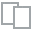
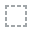
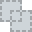
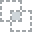
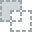
...
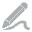
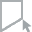
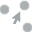
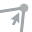
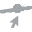

In [9]:
from dataprep.eda import create_report
create_report(order)

## Exploratory data (order table)

### 1. Count total order_id by created_day


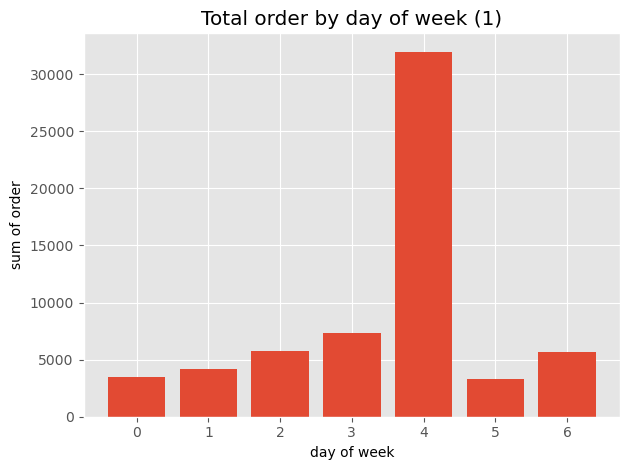

In [10]:
dw_order=order['dayofweek'].value_counts().reset_index().sort_values(by='index')

dow = dw_order['index']
totalorder=dw_order['dayofweek']

plt.style.use('ggplot')
plt.bar(dow, totalorder)

plt.xlabel('day of week')
plt.ylabel('sum of order')

plt.title('Total order by day of week (1)')
plt.tight_layout()

plt.show()



Result : 
- Users have a tendency to gradually increase purchase in weekday. Slightly decrease in the weekend.
-> **the weekday is the active time of the users**
- Thursday has seen a soar in purchse(* explore more below)

In [11]:
# total amount of revenue in July
order['totalamount'].sum()

10065855170

Text(0.5, 1.0, ' Total amount by day of month (2)')

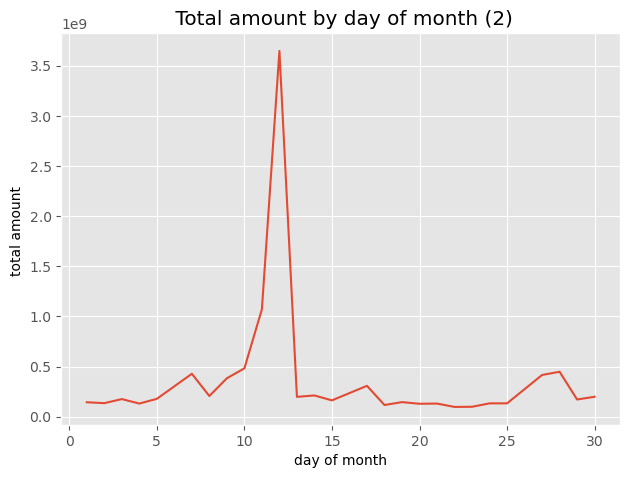

In [12]:
# total amount by day
tm=order.groupby('dayofmonth').sum(['totalamount']).reset_index()
tm.head()

dom= tm['dayofmonth']
amount=tm['totalamount']

plt.plot(dom,amount)

plt.xlabel('day of month')
plt.ylabel('total amount ')

plt.tight_layout()
plt.title(' Total amount by day of month (2)')

From plot (1) & (2):
- **An occational event seemed being happend in 2019-12-07** brings significant result, its revenue is recorded  **10 times as high as it is on other day**, account for **30% of the total amount of the month** (10 billions )

-> **worth to happen periodically**

### 2. What is the distribution of total amount ?

In [13]:
# I divide the amount of order into 6 range amount as below :
rangeamount= []
for index,row in order.iterrows():
    if row['totalamount'] >= 0 and row['totalamount'] <= 100000:
        rangeamount.append('0-100k')
    elif row['totalamount'] >= 100 and row['totalamount'] <= 200000:
        rangeamount.append('101-200k')
    elif row['totalamount'] > 200000 and row['totalamount'] <= 400000:
        rangeamount.append('201-400k')
    elif row['totalamount'] > 400000 and row['totalamount'] < 600000:
        rangeamount.append('401-600k')
    elif row['totalamount'] > 600000 and row['totalamount'] < 800000:
        rangeamount.append('601k-800k')
    elif row['totalamount'] > 800000 and row['totalamount'] < 1000000:
        rangeamount.append('801- 1000k')
    else: rangeamount.append('>2000k')

# append value to order table        
order['rangeamount'] = rangeamount


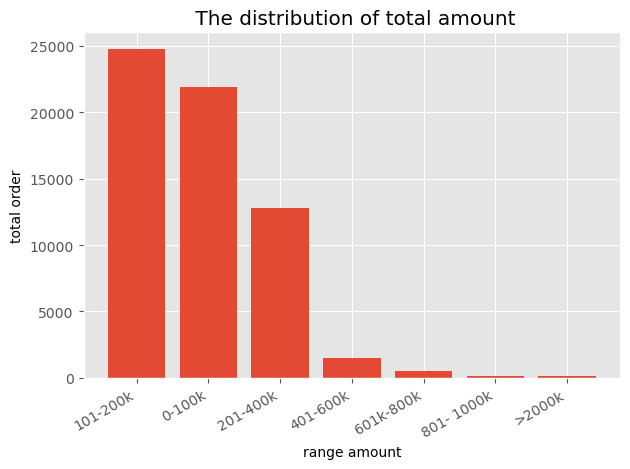

In [14]:
# Create plot shows the distribution of total amount

binsamount=order['rangeamount'].value_counts().reset_index()

range_=binsamount['index'].unique()
totalorder= binsamount['rangeamount']

plt.bar(range_, totalorder)
#plt.pie(totalorder, labels=totalorder, shadow=True, startangle=90, autopct='%1.1f%%')
plt.xlabel('range amount')
plt.ylabel('total order')
plt.title(' The distribution of total amount')

plt.gcf().autofmt_xdate()

plt.tight_layout()

plt.show()

Answer :
- **75% purchase have a range from 0-200k**
- 95% purchase have a range from 0-400k.


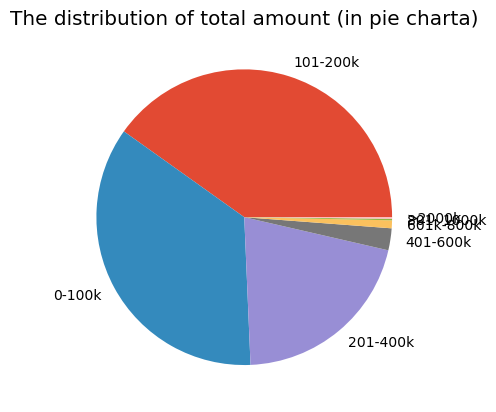

In [15]:
plt.pie(totalorder, labels=range_)
plt.title('The distribution of total amount (in pie charta)')
plt.show()


### 3. With the different rangeamount, is there any diffrerence in prefered payment_method

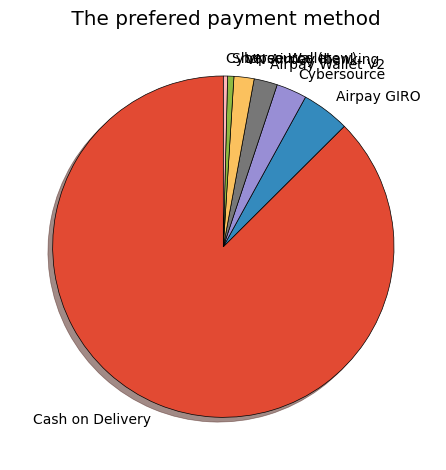

In [16]:
# The prefered payment_method:
pm=order['payment_method_new'].value_counts().reset_index()
pm.head()

slices=pm['payment_method_new']
labels=pm['index']

plt.pie(slices, labels=labels, shadow=True, startangle=90, wedgeprops={'edgecolor':'black'})

plt.title(' The prefered payment method')
plt.tight_layout()
plt.show()


Result : **Cash on Delivery accounts for 87,5% of method** in general

In [17]:
# The relationship of range amount vs cancel ratio.
pivot1=pd.pivot_table(order, index='rangeamount',columns='order_status', values='order_id', aggfunc='count').reset_index()
pivot1['percent']= pivot1['CANCELLED']*100/ (pivot1['CANCELLED']+ pivot1['COMPLETED'])
pivot1

order_status,rangeamount,CANCELLED,COMPLETED,percent
0,0-100k,4256,17679,19.402781
1,101-200k,4895,19885,19.753834
2,201-400k,2407,10386,18.814977
3,401-600k,302,1177,20.419202
4,601k-800k,100,434,18.726592
5,801- 1000k,22,82,21.153846
6,>2000k,29,74,28.155340


Result : The cancel rate between different range amount purchase is kind of similar around 18%-21%

In [18]:
# calculate total amount of cancel purchase
order.loc[order['order_status'] == 'CANCELLED'].sum()['totalamount']

C:\Users\Admin\AppData\Local\Temp\ipykernel_10672\611254721.py:2: FutureWarning: The default value of numeric_only in DataFrame.sum is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  order.loc[order['order_status'] == 'CANCELLED'].sum()['totalamount']


1993771450

**Result :The amount of cancelled purchase is ~2 billions, accounts for 25% total purchase of the month.**
-> Improve the cancel purchase rate will help to cover a propotional revenue

In [19]:
# Phân tính cái đống cancel đơn nè
cancelled=order.loc[order['order_status']== 'CANCELLED']


In [20]:
cancelled['payment_method_new'].value_counts()

Cash on Delivery      10418
VN Airpay Ibanking      715
Airpay GIRO             597
Airpay Wallet V2        168
Cybersource              51
Cybersource (new)        37
Shopee Wallet            25
Name: payment_method_new, dtype: int64

**90% of the cancelled purchase bill** *came from Cash on Delivery (10418)(1)*

In [21]:
range_=cancelled['rangeamount'].value_counts().reset_index()
range_


,index,rangeamount
0,101-200k,4895
1,0-100k,4256
2,201-400k,2407
3,401-600k,302
4,601k-800k,100
5,>2000k,29
6,801- 1000k,22


..*fell into the range amount 0-200k(~80%) (2)*

In [22]:
freeship=cancelled.loc[cancelled['shipping_fee'] == 0].reset_index()

In [23]:
freeship['totalamount'].sum()

724776520

Plus,*30% total amount of cancelled purchase is Freeship (3)*

From (1)(2)(3), some ideas(not limited to this) might be considered to alleviate the cancelled ratio:
    - Encourage user to convert to use online payment method instead of cash on delivery.
    - Apply pay in advance rule if in order to apply freeshipcode to small bill


### Summary Key Findings.


    1. The weekday is the active time of users
    2. An occational event seemed being happend in 2019-12-07 bring significant result, its revenue is recorded 10 times as high as it is on other day, account for 30% of the total amount of the month (10 billions ). Worth to happen periodically
    3. 75% purchase have a range from 0-200k. Cash on Delivery is the most favored payment method with 87.5%
    4. The amount of cancelled purchase is ~2 billions, accounts for 25% total purchase of the month.
    5. 90% of the cancelled purchase bill came from Cash on Delivery, in range 0-200k, 30% of them has Freeship applied

### Part 3 : Provide concrete action to achieve KPI 20bil VND in Aug. How and Why ?



- July - achieves 10Bils+ VND for gross revenue
- Aug - want to double this achievement.

As KPI in August is to reach 20B VND for gross revenue. Then in order to provide concrete action plan on how to achieve that KPI. I start to explore traffic dataset.

  0%|                                                                                         | 0/2093 [00:00<…

C:\Users\Admin\anaconda3\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
C:\Users\Admin\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))


DataPrep Report
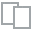
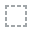
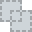
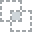
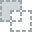
...
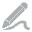
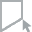
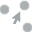
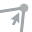
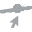

In [24]:
from dataprep.eda import create_report
create_report(traffic)

From Correlations chart from EDA, factors which have high positive corelation on Revenue is: new users(1) | users(1) | sessions(0.98) | transactions(1)

It easily can see that: the more new users -> more users -> increase sessions & transactions.



In [25]:
traffic.corr(method='pearson')

C:\Users\Admin\AppData\Local\Temp\ipykernel_10672\1036525192.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  traffic.corr(method='pearson')


,Users,New Users,Sessions,Bounce Rate,Pages / Session,Avg. Session Duration,Ecommerce Conversion Rate,Transactions,Revenue,user/transaction
Users,1.000000,0.999062,0.992523,0.017306,0.000125,-0.001859,0.032097,0.998002,0.997083,0.017590
New Users,0.999062,1.000000,0.988076,0.014806,0.001580,-0.001133,0.031472,0.999157,0.998846,0.012072
Sessions,0.992523,0.988076,1.000000,0.023696,-0.003669,-0.004421,0.030448,0.984431,0.983645,0.026269
Bounce Rate,0.017306,0.014806,0.023696,1.000000,-0.573411,-0.464566,-0.107963,0.012271,0.011177,0.666013
Pages / Session,0.000125,0.001580,-0.003669,-0.573411,1.000000,0.521583,0.126407,0.003874,0.004978,-0.604414
Avg. Session Duration,-0.001859,-0.001133,-0.004421,-0.464566,0.521583,1.000000,0.053318,0.001378,0.002728,-0.440630
Ecommerce Conversion Rate,0.032097,0.031472,0.030448,-0.107963,0.126407,0.053318,1.000000,0.034682,0.034866,-0.458430
Transactions,0.998002,0.999157,0.984431,0.012271,0.003874,0.001378,0.034682,1.000000,0.999639,0.003963
Revenue,0.997083,0.998846,0.983645,0.011177,0.004978,0.002728,0.034866,0.999639,1.000000,0.003177
user/transaction,0.017590,0.012072,0.026269,0.666013,-0.604414,-0.440630,-0.458430,0.003963,0.003177,1.000000


- Revenue and Users has correlation is 0.998. This means that as the number of users increases, the revenue tends to increase as well.
- To predict the number of users needed ro reach goal of 20 billions in August, we use linear relationship established from the July data.
- Assume :

R = aU + b

10065855170 = a * 656990 + b

-> Usse the correlation to calculate value of a:
r=0.998
a=r*(stdR/stdU) -> a=6.56 -> b=10061539529.950537


Apply to formula : in order to get 20 billions revenue in August, we need to reah
20.000.000.000 = 0.15 * U + 10061539529.950537

-> Need to **have around 1.512.978.160 users to reach KPI based on current operation**

So Where to allocate this number?

In [26]:
order['totalamount'].sum()

10065855170

In [27]:
import statistics
stdv_users=statistics.stdev(traffic['Users'])
stdv_revenue=statistics.stdev(order['totalamount'])
# calculate a
a=0.998 * (stdv_revenue/stdv_users)
print(a)

6.568806297604096


In [28]:
stdv_revenue=statistics.stdev(order['totalamount'])
print(stdv_revenue)

198264.89476082922


In [29]:
# calculate a
a=0.998 * (stdv_revenue/stdv_users)
print(a)

6.568806297604096


In [30]:
b = 10065855170 - a*656990
print(b)

10061539529.950537


In [31]:
U= (20000000000 - b)/a
print(U)

1512978160.6856656


In [32]:
traffic['Users'].sum()

656990

In [34]:
0.15*65517930115.36359 + 10065756621.5


19893446138.804535

In [35]:
# Choose top 10 popular source
core_traffic=traffic.head(10).sort_values(by='Revenue', ascending=False).reset_index()
core_traffic=core_traffic[['Source / Medium','Revenue','user/transaction','Ecommerce Conversion Rate']]
core_traffic

,index,Source / Medium,Users,New Users,Sessions,Bounce Rate,Pages / Session,Avg. Session Duration,Ecommerce Conversion Rate,Transactions,Revenue,user/transaction
0,0,google / cpc,407950,344502,723208,0.621901,3.556041,176.025681,0.009079,6566,6.656088e+09,62.130673
1,2,(direct) / (none),64653,60181,108534,0.553264,4.120340,200.429165,0.009656,1048,1.040851e+09,61.691794
2,1,youtube / social,77785,55537,163447,0.788115,2.244324,89.944740,0.005855,957,8.429079e+08,81.280042
3,3,facebook / social,48721,32781,176662,0.844002,1.858996,73.206094,0.002830,500,5.344857e+08,97.442000
4,4,youtube.com / referral,27718,17774,42464,0.639224,2.983563,148.443882,0.011963,508,4.025419e+08,54.562992
5,6,l.facebook.com / referral,3661,1712,7144,0.370521,6.868421,736.728024,0.014418,103,1.508016e+08,35.543689
6,5,m.facebook.com / referral,14373,10110,17631,0.699733,2.241960,87.386422,0.007203,127,1.141888e+08,113.173228
7,7,zalo / zalo,2782,2400,4029,0.668404,2.534624,147.251179,0.010673,43,3.732781e+07,64.697674
8,9,facebook.com / referral,1594,694,2557,0.495894,4.674228,288.270630,0.011341,29,2.093145e+07,54.965517
9,8,youtube / (not set),1741,875,2311,0.794461,2.078321,68.363912,0.003029,7,9.263414e+06,248.714286


In [37]:
# IQR of Ecommerce Conversion Rate
core_traffic['Ecommerce Conversion Rate'].describe()


count    10.000000
mean      0.008605
std       0.003831
min       0.002830
25%       0.006192
50%       0.009367
75%       0.011174
max       0.014418
Name: Ecommerce Conversion Rate, dtype: float64

In [38]:
# IQR of user/transaction
core_traffic['user/transaction'].describe()

count     10.000000
mean      87.420190
std       60.972706
min       35.543689
25%       56.647086
50%       63.414174
75%       93.401510
max      248.714286
Name: user/transaction, dtype: float64

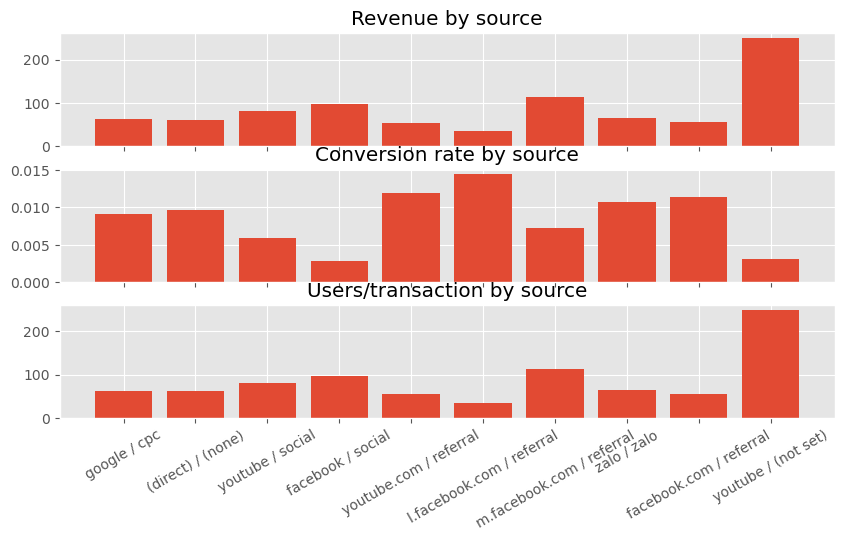

In [39]:
#create plot
source=core_traffic['Source / Medium']
revenue= core_traffic['user/transaction']
cvsrate=core_traffic['Ecommerce Conversion Rate']
users=core_traffic['user/transaction']

fig, (ax1, ax2,ax3)= plt.subplots(nrows=3, ncols=1, sharex=True, figsize=(10,5))


ax1.bar(source,revenue )
ax2.bar(source,cvsrate)
ax3.bar(source,users)

ax1.set_title('Revenue by source')
ax2.set_title('Conversion rate by source')
ax3.set_title('Users/transaction by source')

plt.xticks(rotation=30)
plt.show()

Here's the characteristics of top  7 sources:
- **Google(cpc)** : bring 65% of total revenue in July, running by google advetising, cost per click
- **direct** : bring 10% of total revenue in July.
- **Facebook Referral**: this word-of-mouth way has the high conversion rate compared to others(0.1) -> potential to convert them into future client.
- **youtube(social)** : bring good revenue(3rd) revenue without cpc
- **facebook social** :  average conversion rate, page/session = ~ 2-> User from this source have the quick decision making and close the deal
- **zalo** : small market, high conversion rate(0.01)


    

### Summary Action Plan

In summary, in order to achive the KPI 20 billions VND in Aug, some action must be taken to make it happen:

**A. In general operation**

1. **Eliminate the cancel rate by** encouraging user(who have purchase from 0-200k) pay online inadvance instead of Cash on Delivery | apply freeship rule ( in July, it account for 20%)

2. **Organize Monthly event sales** in Aug (as in July, it's almost a third of total revenue) 

-> This action could help us to find a way to cover

**B. In specific source**

How to allocate to different source:
- **Google(cpc) (65%)** : continue to optimize the cost to run advertising on Google cpc as it works
- **direct (10%)** : continue to try and grow marketing strategies to different customer segmentation in order to raise brand awareness (it also save cost for running advertising as cpc..)

**The rest allocate equally to the source below**, craft the content based on its characteristics to speak for |meet new potential users:

- **Facebook Referral**: this word-of-mouth way has the high conversion rate compared to others(0.1) -> potential to convert them into future client.
- **youtube(social)** : bring good revenue(3rd) revenue without cpc
- **facebook social** :  average conversion rate, page/session = ~ 2-> User from this source have the quick decision making and close the deal
- **zalo** : small market, high conversion rate(0.01)

